# 1. Set up the notebook

Do imports.

In [286]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks
from IPython.display import Image
from ae483tools import *

# 2. Estimate the mass

Find the mass $m$ of the drone in kilograms.

In [287]:
m = 0.0344 # <-- fixed

Find a worst-case bound $\Delta m$ on the uncertainty of your estimate. This bound should be chosen so that the true mass is guaranteed to be in the interval $[m - \Delta m, m + \Delta m]$.

In [288]:
delta_m = 0.0001 # <-- fixed

# 3. Estimate the moment of inertia about the $x_B$-axis

Show a picture of your rig (change the file name or file extension as appropriate).

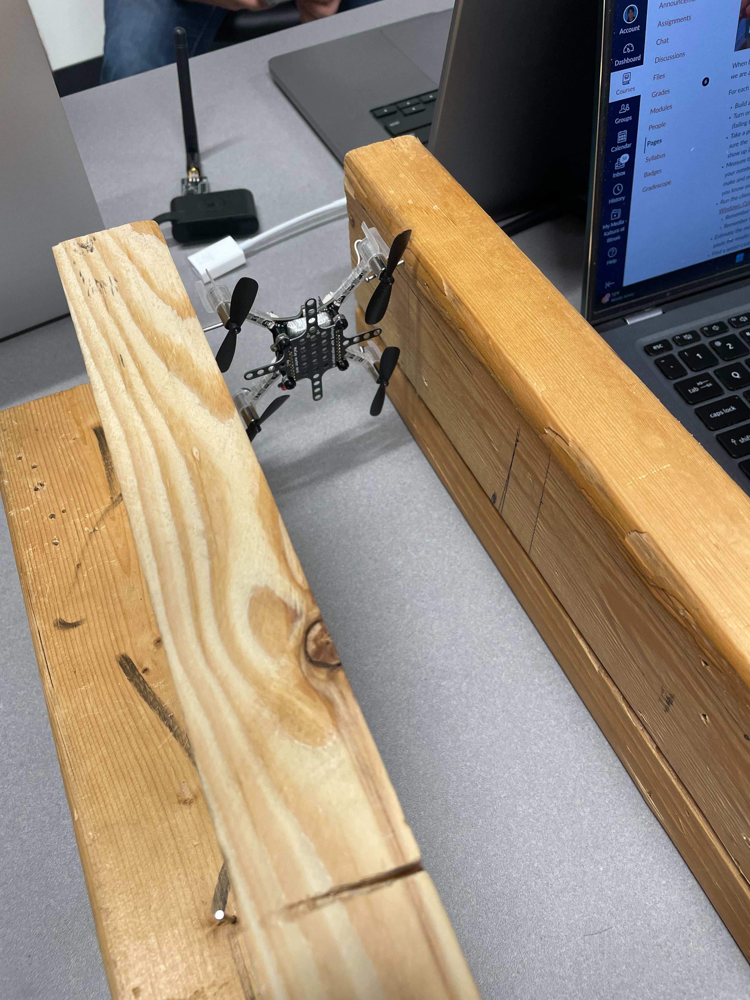

In [289]:
Image(filename='x-rig.png', width=480)

Find the distance in meters between the axis of rotation and the center of mass.

In [290]:
r_x = 0.02938526 # <-- fixed

Find a worst-case bound $\Delta r$ on the uncertainty of your estimate.

In [291]:
delta_r = 0.0001 # <-- fixed

Load, resample, and parse data to get time and the three components of angular velocity (in radians / second).

Remember that `resample_drone_data` has two optional arguments that allow you to discard data at the start and end of the experiment. You may find these arguments useful, since you will likely find that some of the data at the start and end of your experiment are garbage.

In [292]:
# Load data
raw_data_drone, raw_data_mocap = load_hardware_data('x_data.json')

# Resample data
data_drone = resample_data_drone(
    raw_data_drone,
    t_min_offset=1.,    # <-- FIXME
    t_max_offset=4.,    # <-- FIXME
)

# Parse data
t = data_drone['time']
w_x = np.deg2rad(data_drone['gyro.x'])
w_y = np.deg2rad(data_drone['gyro.y'])
w_z = np.deg2rad(data_drone['gyro.z'])

Plot all three components of angular velocity. You are trying to estimate the moment of inertia about the $x$ axis. The component of angular velocity about this axis should be large, and the components of angular velocity about the other two axes should be negligibly small. It is important to check this. (Please also check if you have data at the start and end of the experiment that need to be discarded.)

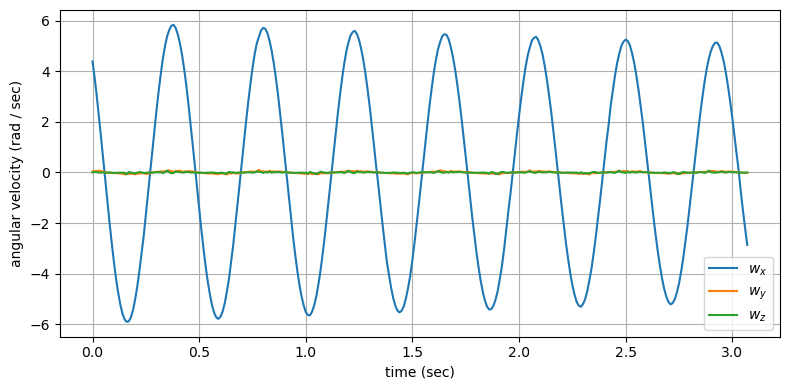

In [293]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t, w_x, label='$w_x$')
ax.plot(t, w_y, label='$w_y$')
ax.plot(t, w_z, label='$w_z$')
ax.set_xlabel('time (sec)')
ax.set_ylabel('angular velocity (rad / sec)')
ax.legend()
ax.grid()
plt.show()

You should find that `w_x` is oscillatory. The period is the peak-to-peak time. You could measure the period by hand, but it is easier to automate this process, particularly if you want to average your estimate of the period over many oscillations.

Here is one way to do it:

* Find the index $i_k$ of each peak $k\in\{0, \dotsc, n-1\}$ in your data.
* Find the time $t_k$ at each peak for $k\in\{0, \dotsc, n-1\}$.
* Find the difference $T_k = t_{k+1} - t_k$ between consecutive peak times for $k \in \{0, \dotsc, n-2\}$.
* Find the mean difference: $$\widehat{T} = \dfrac{1}{n-1} \sum_{k=0}^{n-2} T_k.$$ This is an estimate of the oscillation period.

Here is one way to implement this in code, using [scipy.signal.find_peaks](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.find_peaks.html):

In [294]:
# Find the index of each peak (increase "prominence" if you get bad results)
peaks = find_peaks(w_x, prominence=0)
i_peaks = peaks[0]

# Find the time at each peak
t_peaks = t[i_peaks]

# Find w_x at each peak (for visualization)
w_x_peaks = w_x[i_peaks]

# Find the difference between consecutive peak times
#
# Note:
#
#  t_peaks[1:] means t_peaks without the first element
#  t_peaks[:-1] means t_peaks without the last element
#
# So, t_peaks[1:] - t_peaks[:-1] produces the following array:
#
#  [t_peaks[1]-t_peaks[0], t_peaks[0]-t_peaks[1], ...]
#
t_diff = t_peaks[1:] - t_peaks[:-1]

# Find the mean difference as an estimate of the oscillation period
T_x = np.mean(t_diff)

# Print the estimate
print(f'T = {T_x:.4f} sec')

T = 0.4233 sec


Sanity check — plot the peaks. (**FIXME: How do you know these results are good?**)

**The orange plotted peaks line up with the peaks on the plotted motion**

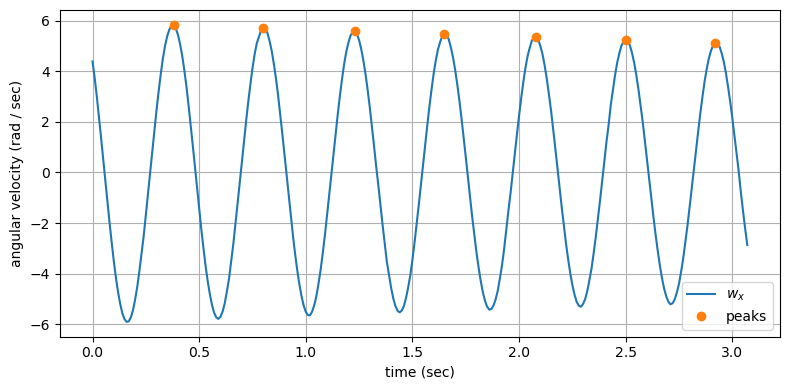

In [295]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t, w_x, label='$w_x$')
ax.plot(t_peaks, w_x_peaks, '.', markersize=12, label='peaks')
ax.set_xlabel('time (sec)')
ax.set_ylabel('angular velocity (rad / sec)')
ax.legend()
ax.grid()
plt.show()

Sanity check — plot the differences between consecutive peak times. (**FIXME: How do you know these results are good?**)

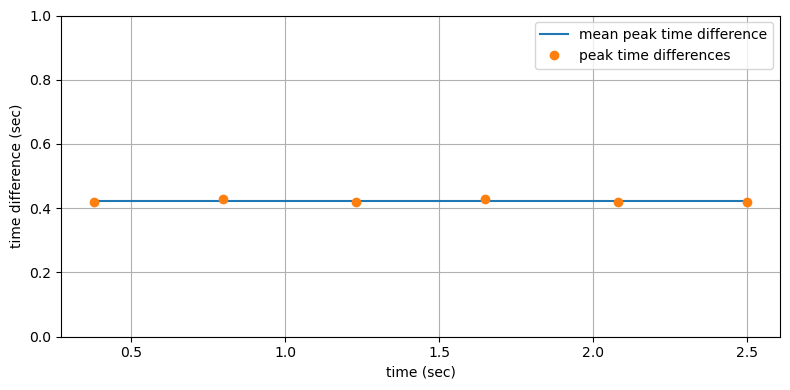

In [296]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t_peaks[:-1], T_x * np.ones_like(t_peaks[:-1]), label='mean peak time difference')
ax.plot(t_peaks[:-1], t_diff, '.', markersize=12, label='peak time differences')
ax.set_ylim(0., 1.)
ax.set_xlabel('time (sec)')
ax.set_ylabel('time difference (sec)')
ax.grid()
ax.legend()
plt.show()

Find a worst-case bound $\Delta T$ on the uncertainty of your estimate.

In [297]:
delta_T = 0.01 # <-- fixed

Find the moment of inertia about the $x$ axis.

In [298]:
g = 9.81


In [299]:
J_x = (((m * g * r_x * (T_x**2)) / (4 * (np.pi**2)))) - (m * (r_x**2)) # <-- fixed
J_x

1.5311334308608753e-05

Find a worst-case bound $\Delta J_x$ on the uncertainty in your estimate.

In [300]:
delta_J_dm = (g*r_x*(T_x**2))/(4*np.pi**2) - r_x**2
delta_J_dr = (m*g*T_x**2)/(4*np.pi**2) - 2*m*r_x
delta_J_dT = (m*g*r_x*T_x)/(2*np.pi**2)
delta_J_x = (delta_J_dm * delta_m) + (delta_J_dr * delta_r) + (delta_J_dT * delta_T)
delta_J_x

2.122246940304537e-06

# 4. Estimate the moment of inertia about the $y_B$-axis

Add cells here to repeat the same process as above...

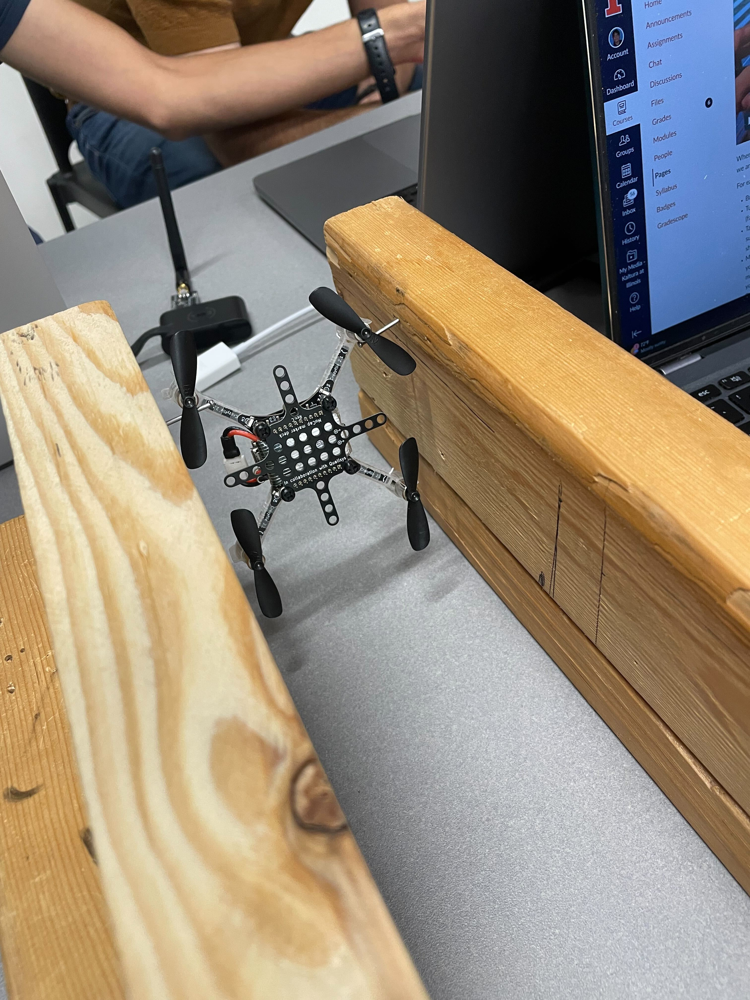

In [301]:
Image(filename='y-rig.png', width=480)

Find the distance in meters between the axis of rotation and the center of mass.

In [302]:
r_y = 0.02862 # <-- fixed

Find a worst-case bound $\Delta r$ on the uncertainty of your estimate.

In [303]:
delta_r = 0.0001 # <-- fixed

Load, resample, and parse data to get time and the three components of angular velocity (in radians / second).

Remember that `resample_drone_data` has two optional arguments that allow you to discard data at the start and end of the experiment. You may find these arguments useful, since you will likely find that some of the data at the start and end of your experiment are garbage.

In [304]:
# Load data
raw_data_drone, raw_data_mocap = load_hardware_data('y_data.json')

# Resample data
data_drone = resample_data_drone(
    raw_data_drone,
    t_min_offset=1.,    # <-- FIXME
    t_max_offset=4.,    # <-- FIXME
)

# Parse data
t = data_drone['time']
w_x = np.deg2rad(data_drone['gyro.x'])
w_y = np.deg2rad(data_drone['gyro.y'])
w_z = np.deg2rad(data_drone['gyro.z'])

Plot all three components of angular velocity. You are trying to estimate the moment of inertia about the $x$ axis. The component of angular velocity about this axis should be large, and the components of angular velocity about the other two axes should be negligibly small. It is important to check this. (Please also check if you have data at the start and end of the experiment that need to be discarded.)

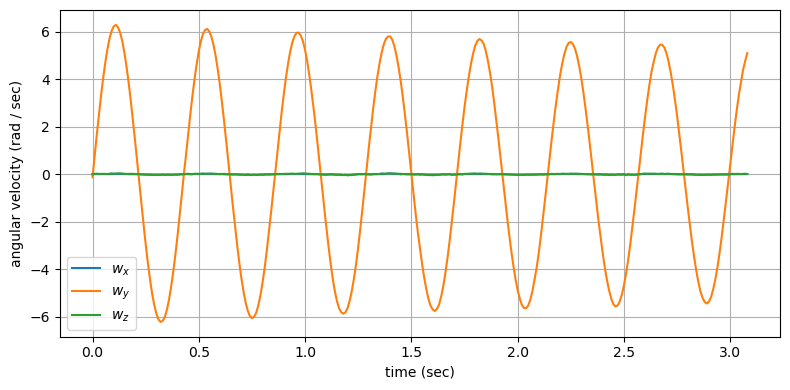

In [305]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t, w_x, label='$w_x$')
ax.plot(t, w_y, label='$w_y$')
ax.plot(t, w_z, label='$w_z$')
ax.set_xlabel('time (sec)')
ax.set_ylabel('angular velocity (rad / sec)')
ax.legend()
ax.grid()
plt.show()

You should find that `w_x` is oscillatory. The period is the peak-to-peak time. You could measure the period by hand, but it is easier to automate this process, particularly if you want to average your estimate of the period over many oscillations.

Here is one way to do it:

* Find the index $i_k$ of each peak $k\in\{0, \dotsc, n-1\}$ in your data.
* Find the time $t_k$ at each peak for $k\in\{0, \dotsc, n-1\}$.
* Find the difference $T_k = t_{k+1} - t_k$ between consecutive peak times for $k \in \{0, \dotsc, n-2\}$.
* Find the mean difference: $$\widehat{T} = \dfrac{1}{n-1} \sum_{k=0}^{n-2} T_k.$$ This is an estimate of the oscillation period.

Here is one way to implement this in code, using [scipy.signal.find_peaks](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.find_peaks.html):

In [306]:
# Find the index of each peak (increase "prominence" if you get bad results)
peaks = find_peaks(w_y, prominence=0)
i_peaks = peaks[0]

# Find the time at each peak
t_peaks = t[i_peaks]

# Find w_x at each peak (for visualization)
w_y_peaks = w_y[i_peaks]

# Find the difference between consecutive peak times
#
# Note:
#
#  t_peaks[1:] means t_peaks without the first element
#  t_peaks[:-1] means t_peaks without the last element
#
# So, t_peaks[1:] - t_peaks[:-1] produces the following array:
#
#  [t_peaks[1]-t_peaks[0], t_peaks[0]-t_peaks[1], ...]
#
t_diff = t_peaks[1:] - t_peaks[:-1]

# Find the mean difference as an estimate of the oscillation period
T_y = np.mean(t_diff)

# Print the estimate
print(f'T = {T_y:.4f} sec')

T = 0.4267 sec


Sanity check — plot the peaks. (**FIXME: How do you know these results are good?**)

**The orange plotted peaks line up with the peaks on the plotted motion**

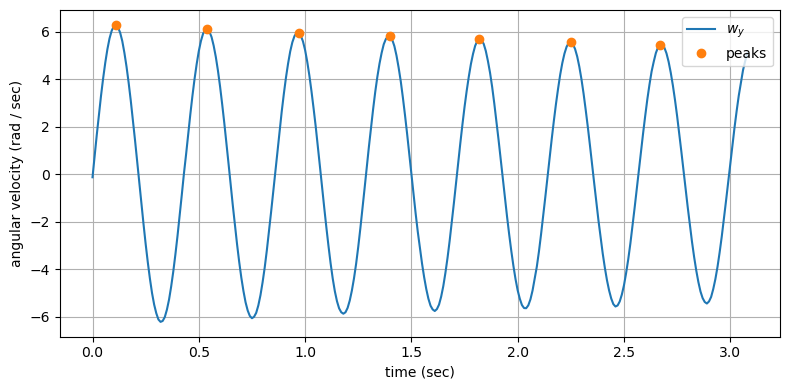

In [307]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t, w_y, label='$w_y$')
ax.plot(t_peaks, w_y_peaks, '.', markersize=12, label='peaks')
ax.set_xlabel('time (sec)')
ax.set_ylabel('angular velocity (rad / sec)')
ax.legend()
ax.grid()
plt.show()

Sanity check — plot the differences between consecutive peak times. (**FIXME: How do you know these results are good?**)

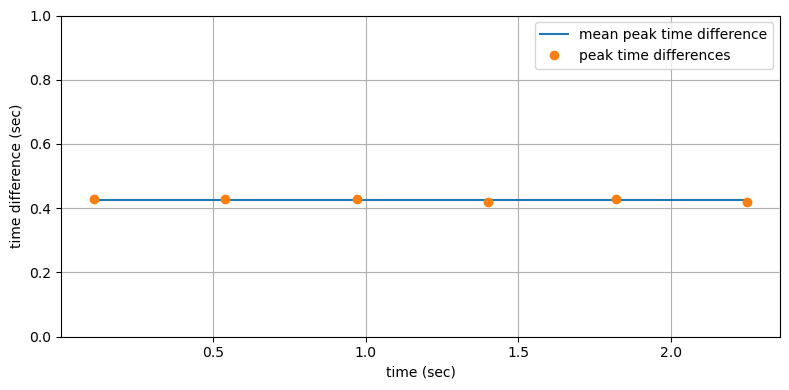

In [308]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t_peaks[:-1], T_y * np.ones_like(t_peaks[:-1]), label='mean peak time difference')
ax.plot(t_peaks[:-1], t_diff, '.', markersize=12, label='peak time differences')
ax.set_ylim(0., 1.)
ax.set_xlabel('time (sec)')
ax.set_ylabel('time difference (sec)')
ax.grid()
ax.legend()
plt.show()

Find a worst-case bound $\Delta T$ on the uncertainty of your estimate.

In [309]:
delta_T = 0.01 # <-- fixed

Find the moment of inertia about the $x$ axis.

In [310]:
g = 9.81


In [311]:
J_y = (((m * g * r_y * (T_y**2)) / (4 * (np.pi**2)))) - (m * (r_y**2)) # <-- fixed
J_y

1.6359174144526616e-05

Find a worst-case bound $\Delta J_y$ on the uncertainty in your estimate.

In [312]:
delta_J_dm = (g*r_y*(T_y**2))/(4*np.pi**2) - r_y**2
delta_J_dr = (m*g*T_y**2)/(4*np.pi**2) - 2*m*r_y
delta_J_dT = (m*g*r_y*T_y)/(2*np.pi**2)
delta_J_y = (delta_J_dm * delta_m) + (delta_J_dr * delta_r) + (delta_J_dT * delta_T)
delta_J_y

2.093905009428816e-06

# 5. Estimate the moment of inertia about the $z_B$-axis

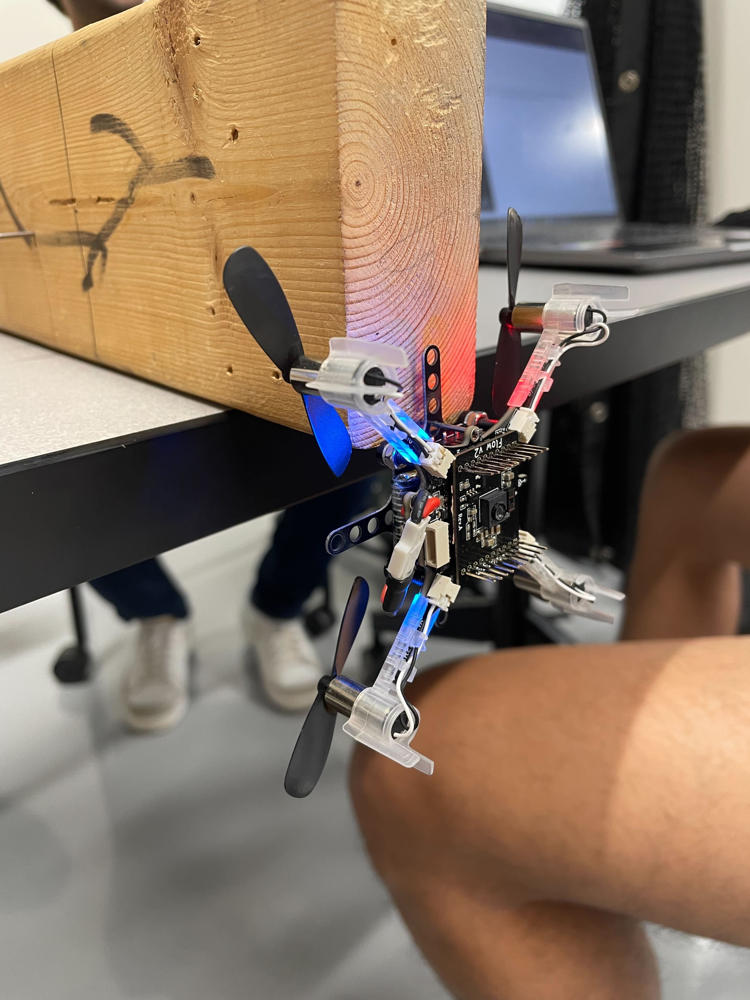

In [313]:
Image(filename='z-rig.png', width=480)

Find the distance in meters between the axis of rotation and the center of mass.

In [314]:
r_z = 0.01508 # <-- fixed

Find a worst-case bound $\Delta r$ on the uncertainty of your estimate.

In [315]:
delta_r = 0.0001 # <-- fixed

Load, resample, and parse data to get time and the three components of angular velocity (in radians / second).

Remember that `resample_drone_data` has two optional arguments that allow you to discard data at the start and end of the experiment. You may find these arguments useful, since you will likely find that some of the data at the start and end of your experiment are garbage.

In [316]:
# Load data
raw_data_drone, raw_data_mocap = load_hardware_data('z_data.json')

# Resample data
data_drone = resample_data_drone(
    raw_data_drone,
    t_min_offset=1.,    # <-- FIXME
    t_max_offset=4.,    # <-- FIXME
)

# Parse data
t = data_drone['time']
w_x = np.deg2rad(data_drone['gyro.x'])
w_y = np.deg2rad(data_drone['gyro.y'])
w_z = np.deg2rad(data_drone['gyro.z'])

Plot all three components of angular velocity. You are trying to estimate the moment of inertia about the $x$ axis. The component of angular velocity about this axis should be large, and the components of angular velocity about the other two axes should be negligibly small. It is important to check this. (Please also check if you have data at the start and end of the experiment that need to be discarded.)

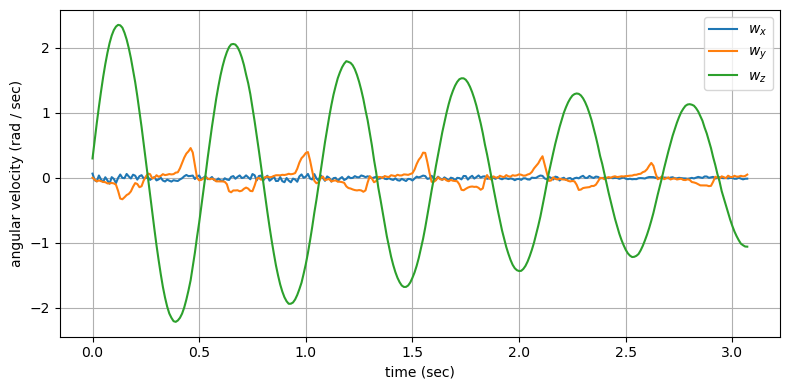

In [317]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t, w_x, label='$w_x$')
ax.plot(t, w_y, label='$w_y$')
ax.plot(t, w_z, label='$w_z$')
ax.set_xlabel('time (sec)')
ax.set_ylabel('angular velocity (rad / sec)')
ax.legend()
ax.grid()
plt.show()

You should find that `w_x` is oscillatory. The period is the peak-to-peak time. You could measure the period by hand, but it is easier to automate this process, particularly if you want to average your estimate of the period over many oscillations.

Here is one way to do it:

* Find the index $i_k$ of each peak $k\in\{0, \dotsc, n-1\}$ in your data.
* Find the time $t_k$ at each peak for $k\in\{0, \dotsc, n-1\}$.
* Find the difference $T_k = t_{k+1} - t_k$ between consecutive peak times for $k \in \{0, \dotsc, n-2\}$.
* Find the mean difference: $$\widehat{T} = \dfrac{1}{n-1} \sum_{k=0}^{n-2} T_k.$$ This is an estimate of the oscillation period.

Here is one way to implement this in code, using [scipy.signal.find_peaks](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.find_peaks.html):

In [318]:
# Find the index of each peak (increase "prominence" if you get bad results)
peaks = find_peaks(w_z, prominence=0)
i_peaks = peaks[0]

# Find the time at each peak
t_peaks = t[i_peaks]

# Find w_x at each peak (for visualization)
w_z_peaks = w_z[i_peaks]

# Find the difference between consecutive peak times
#
# Note:
#
#  t_peaks[1:] means t_peaks without the first element
#  t_peaks[:-1] means t_peaks without the last element
#
# So, t_peaks[1:] - t_peaks[:-1] produces the following array:
#
#  [t_peaks[1]-t_peaks[0], t_peaks[0]-t_peaks[1], ...]
#
t_diff = t_peaks[1:] - t_peaks[:-1]

# Find the mean difference as an estimate of the oscillation period
T_z = np.mean(t_diff)

# Print the estimate
print(f'T = {T_z:.4f} sec')

T = 0.5360 sec


Sanity check — plot the peaks. (**FIXME: How do you know these results are good?**)

**The orange plotted peaks line up with the peaks on the plotted motion**

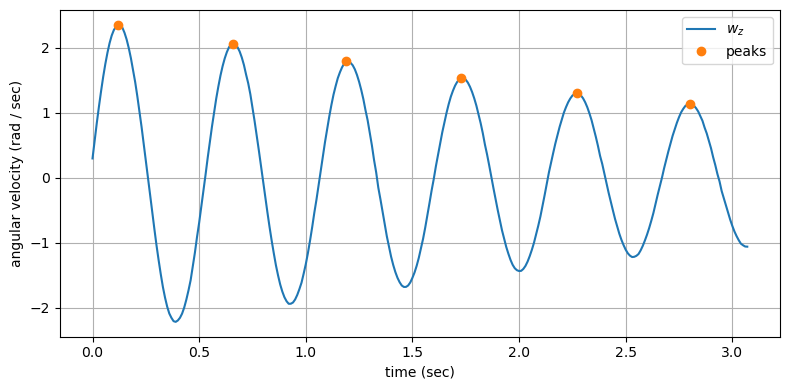

In [319]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t, w_z, label='$w_z$')
ax.plot(t_peaks, w_z_peaks, '.', markersize=12, label='peaks')
ax.set_xlabel('time (sec)')
ax.set_ylabel('angular velocity (rad / sec)')
ax.legend()
ax.grid()
plt.show()

Sanity check — plot the differences between consecutive peak times. (**FIXME: How do you know these results are good?**)

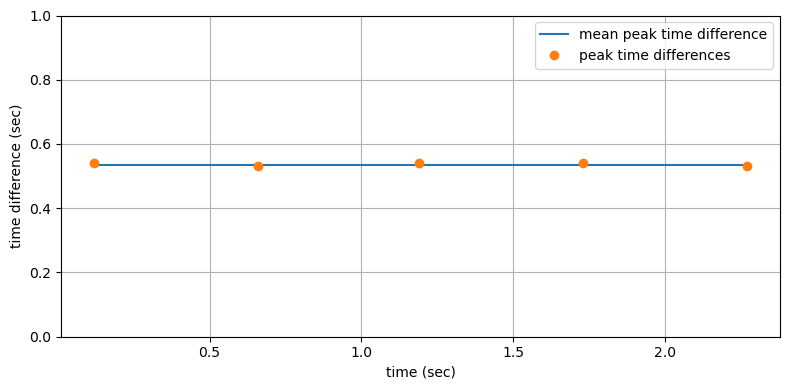

In [320]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t_peaks[:-1], T_z * np.ones_like(t_peaks[:-1]), label='mean peak time difference')
ax.plot(t_peaks[:-1], t_diff, '.', markersize=12, label='peak time differences')
ax.set_ylim(0., 1.)
ax.set_xlabel('time (sec)')
ax.set_ylabel('time difference (sec)')
ax.grid()
ax.legend()
plt.show()

Find a worst-case bound $\Delta T$ on the uncertainty of your estimate.

In [321]:
delta_T = 0.01 # <-- fixed

Find the moment of inertia about the $x$ axis.

In [322]:
g = 9.81


In [323]:
J_z = (((m * g * r_z * (T_z**2)) / (4 * (np.pi**2)))) - (m * (r_z**2))     # <-- fixed


In [324]:
delta_J_dm = (g*r_z*(T_z**2))/(4*np.pi**2) - r_z**2
delta_J_dr = (m*g*T_z**2)/(4*np.pi**2) - 2*m*r_z
delta_J_dT = (m*g*r_z*T_z)/(2*np.pi**2)
delta_J_z = (delta_J_dm * delta_m) + (delta_J_dr * delta_r) + (delta_J_dT * delta_T)
delta_J_z

1.6086072199494926e-06

# 6. Summarize and discuss the results

### Summary of results

In [325]:
print(f'm = {m:.4f} +/- {delta_m:.4f} kg')
print(f'J_x = {J_x:.2e} +/- {delta_J_x:.2e} kg m^2')
print(f'J_y = {J_y:.2e} +/- {delta_J_y:.2e} kg m^2')
print(f'J_z = {J_z:.2e} +/- {delta_J_z:.2e} kg m^2')

m = 0.0344 +/- 0.0001 kg
J_x = 1.53e-05 +/- 2.12e-06 kg m^2
J_y = 1.64e-05 +/- 2.09e-06 kg m^2
J_z = 2.92e-05 +/- 1.61e-06 kg m^2


### Analysis of uncertainty

**Modify the text in this cell** to answer the following questions:
* Which computed quantities ($J_x$, $J_y$, $J_z$) are the most uncertain?

**J_x is the most uncertain**

* Which measured quantities ($m$, $r$, $T$) contribute the most to uncertainty in the computed quantities?

**r, because it is squared in the numerator**

* What assumptions were made and to what extent were these assumptions violated?

**Assume zero friction on moment of inertia measurements, assume zero air resistance, assume setup only makes drone oscillate in correct axis. Assumptions on friction were likely violated most, assumptions on oscillation were also violated, air resistance likely accounted for less error**

* What sources of error might not be captured in your analysis of uncertainty?

**Friction would not be captured, imperfections in the swing setup would also not be captured**

### Ways to improve the results

**Modify the text in this cell** to propose at least one way in which the experiments or the analysis could be improved to get estimates of mass and moments of inertia that are more accurate (i.e., less uncertain). You could suggest improvements to your current method of approach, but you are also welcome to suggest a completely different method of approach.

Could fabricate better swing setup (maybe 3D print) to ensure more accurate axis control. Could also build better mounting point on drone fuselage for measuring z-axis swing.